#Intro
In this notebook We will explore and perform EDA on the FD002 file. 

|Dataset	|Operating conditions |	Fault modes|	Train size (nr. of engines)	| Test size (nr. of engines)|
|--------|---|---|-----|-----|
| FD002	| 6	| 1	| 260	| 259 |

In [1]:
#%pip install missingno

In [21]:
import seaborn as sns
import os
import pandas as pd
import numpy as np
np.random.seed(1337)
from IPython.display import Image
import matplotlib as mpl
import matplotlib.pyplot as plt
from pandas import read_csv
from matplotlib import pyplot as plt
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler

import missingno as msno

In [22]:
#%pip install missingno

In [23]:
# settings will be used to avoid exponential values in output or tables and to display 50 rows maximum

pd.set_option('display.float_format', lambda x: '%.3f' % x)
pd.options.display.max_rows=50

In [27]:
# Replace 'file.txt' with the name of your .txt file
train = pd.read_csv('nasa/train_FD002.txt', delimiter=' ')

# Print the first few rows of the DataFrame
print(train.head())
print(train.shape)
print(list(train.columns))

   1  1.1  34.9983  0.8400   100.0  449.44  555.32  1358.61  1137.23  5.48  \
0  1    2   41.998   0.841 100.000 445.000 549.900 1353.220 1125.780 3.910   
1  1    3   24.999   0.622  60.000 462.540 537.310 1256.760 1047.450 7.050   
2  1    4   42.008   0.842 100.000 445.000 549.510 1354.030 1126.380 3.910   
3  1    5   25.000   0.620  60.000 462.540 537.070 1257.710 1047.930 7.050   
4  1    6   25.005   0.621  60.000 462.540 537.020 1266.380 1048.720 7.050   

   ...  8048.56  9.3461  0.02  334  2223  100.00  14.73  8.8071  Unnamed: 26  \
0  ... 8072.300   9.377 0.020  330  2212 100.000 10.410   6.266          NaN   
1  ... 7864.870  10.894 0.020  309  1915  84.930 14.080   8.672          NaN   
2  ... 8068.660   9.353 0.020  329  2212 100.000 10.590   6.470          NaN   
3  ... 7861.230  10.896 0.020  309  1915  84.930 14.130   8.529          NaN   
4  ... 7868.870  10.891 0.020  306  1915  84.930 14.280   8.559          NaN   

   Unnamed: 27  
0          NaN  
1          NaN  

In [28]:
# Rename columns
new_col_names = ['unit', 'time', 'op1', 'op2', 'op3', 'sm1', 'sm2', 'sm3', 'sm4', 'sm5', 'sm6', 'sm7', 'sm8', 'sm9', 'sm10', 'sm11', 'sm12', 'sm13', 'sm14', 'sm15', 'sm16', 'sm17', 'sm18', 'sm19', 'sm20', 'sm21', 'HPC', 'FAN']
train = train.rename(columns={train.columns[i]: new_col_names[i] for i in range(len(train.columns))})

## Check for Missing data

<Axes: >

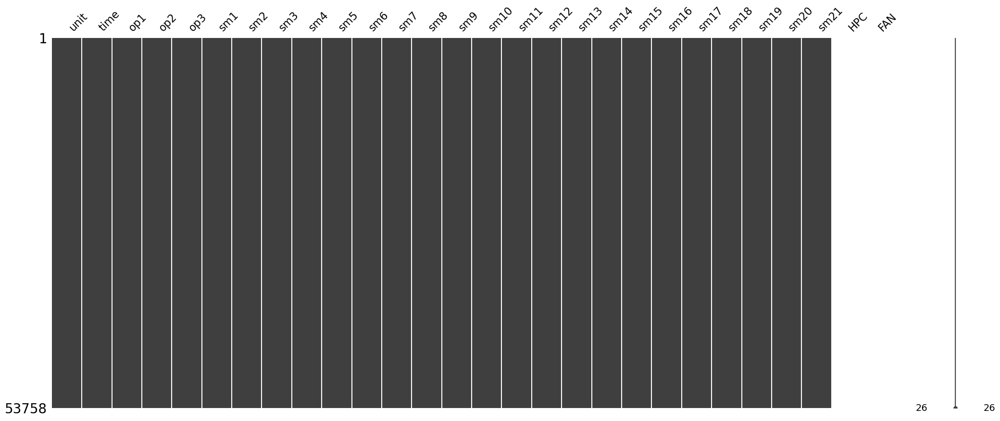

In [29]:
msno.matrix(train)

In [30]:
train.head(5)

,unit,time,op1,op2,op3,sm1,sm2,sm3,sm4,sm5,...,sm14,sm15,sm16,sm17,sm18,sm19,sm20,sm21,HPC,FAN
0,1,2,41.998,0.841,100.000,445.000,549.900,1353.220,1125.780,3.910,...,8072.300,9.377,0.020,330,2212,100.000,10.410,6.266,NaN,NaN
1,1,3,24.999,0.622,60.000,462.540,537.310,1256.760,1047.450,7.050,...,7864.870,10.894,0.020,309,1915,84.930,14.080,8.672,NaN,NaN
2,1,4,42.008,0.842,100.000,445.000,549.510,1354.030,1126.380,3.910,...,8068.660,9.353,0.020,329,2212,100.000,10.590,6.470,NaN,NaN
3,1,5,25.000,0.620,60.000,462.540,537.070,1257.710,1047.930,7.050,...,7861.230,10.896,0.020,309,1915,84.930,14.130,8.529,NaN,NaN
4,1,6,25.005,0.621,60.000,462.540,537.020,1266.380,1048.720,7.050,...,7868.870,10.891,0.020,306,1915,84.930,14.280,8.559,NaN,NaN


In [31]:
train.tail(5)

,unit,time,op1,op2,op3,sm1,sm2,sm3,sm4,sm5,...,sm14,sm15,sm16,sm17,sm18,sm19,sm20,sm21,HPC,FAN
53753,260,312,20.004,0.700,100.000,491.190,608.790,1495.600,1269.510,9.350,...,8169.640,9.303,0.030,369,2324,100.000,24.360,14.519,NaN,NaN
53754,260,313,10.002,0.251,100.000,489.050,605.810,1514.320,1324.120,10.520,...,8245.360,8.759,0.030,374,2319,100.000,28.100,16.945,NaN,NaN
53755,260,314,25.004,0.620,60.000,462.540,537.480,1276.240,1057.920,7.050,...,7971.250,11.066,0.020,310,1915,84.930,14.190,8.550,NaN,NaN
53756,260,315,25.003,0.622,60.000,462.540,537.840,1272.950,1066.300,7.050,...,7972.470,11.054,0.020,311,1915,84.930,14.050,8.373,NaN,NaN
53757,260,316,35.004,0.840,100.000,449.440,556.640,1374.610,1145.520,5.480,...,8185.350,9.400,0.020,338,2223,100.000,14.750,8.845,NaN,NaN


## Looking at the general distribution of the sensor measures and operating modes

In [32]:
train.describe()

,unit,time,op1,op2,op3,sm1,sm2,sm3,sm4,sm5,...,sm14,sm15,sm16,sm17,sm18,sm19,sm20,sm21,HPC,FAN
count,53758.000,53758.000,53758.000,53758.000,53758.000,53758.000,53758.000,53758.000,53758.000,53758.000,...,53758.000,53758.000,53758.000,53758.000,53758.000,53758.000,53758.000,53758.000,0.000,0.000
mean,131.085,109.157,23.998,0.572,94.046,472.911,579.673,1419.972,1205.443,8.032,...,8066.598,9.330,0.023,348.310,2228.806,97.757,20.789,12.473,NaN,NaN
std,74.462,69.180,14.747,0.310,14.238,26.390,37.290,105.947,119.124,3.614,...,84.839,0.749,0.005,27.755,145.329,5.364,9.869,5.922,NaN,NaN
min,1.000,1.000,0.000,0.000,60.000,445.000,535.530,1243.730,1023.770,3.910,...,7848.360,8.336,0.020,303.000,1915.000,84.930,10.180,6.011,NaN,NaN
25%,68.000,52.000,10.005,0.251,100.000,445.000,549.570,1352.760,1123.653,3.910,...,8062.140,8.678,0.020,331.000,2212.000,100.000,10.910,6.546,NaN,NaN
50%,131.000,104.000,25.001,0.700,100.000,462.540,555.980,1369.180,1138.890,7.050,...,8082.540,9.311,0.020,335.000,2223.000,100.000,14.880,8.929,NaN,NaN
75%,195.000,157.000,41.998,0.840,100.000,491.190,607.340,1499.370,1306.850,10.520,...,8127.198,9.387,0.030,369.000,2324.000,100.000,28.470,17.083,NaN,NaN
max,260.000,378.000,42.008,0.842,100.000,518.670,644.520,1612.880,1439.230,14.620,...,8268.500,11.067,0.030,399.000,2388.000,100.000,39.340,23.590,NaN,NaN


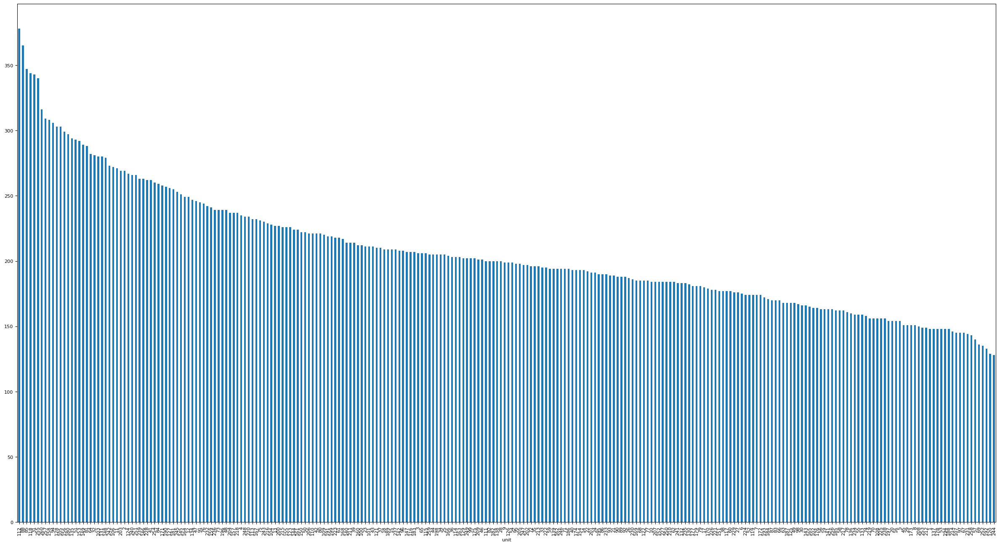

In [46]:
plt.figure(figsize=(30,16))
train.unit.value_counts().plot.bar()
plt.xticks(rotation=90)
plt.rcParams.update({'font.size': 8})

### Lets look at the sensor data for unit 1

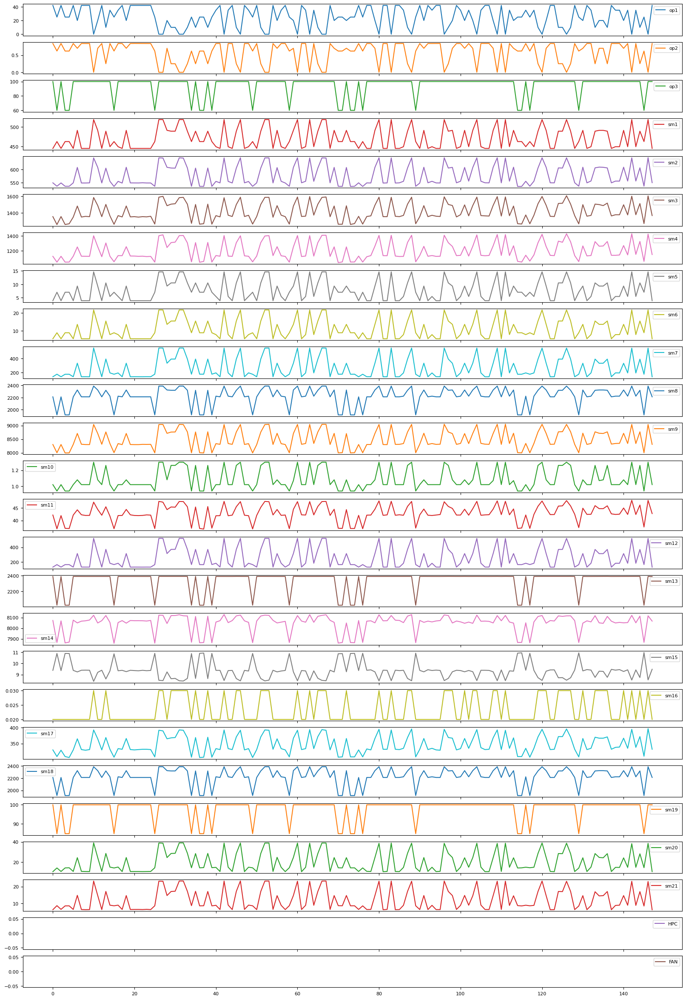

In [47]:
### plotting sensor data for engine ID  - Unit 1
engine_unit = train[train['unit'] == 1]

ax1 = engine_unit[train.columns[2:]].plot(subplots=True, figsize=(20,30))

In [48]:

### CALCULATE RUL TRAIN ###
train['RUL']=train.groupby(['unit'])['time'].transform(max)-train['time']
train.RUL[0:10]

0    147
1    146
2    145
3    144
4    143
5    142
6    141
7    140
8    139
9    138
Name: RUL, dtype: int64

In [49]:
### ADD NEW LABEL TRAIN ###
w1 = 45
w0 = 15
train['label1'] = np.where(train['RUL'] <= w1, 1, 0 )
train['label2'] = train['label1']
train.loc[train['RUL'] <= w0, 'label2'] = 2

In [50]:
train_OG = train.copy()

### SCALE TRAIN DATA ###

def scale(df):
    return (df - df.mean())/df.std()
    return (df - df.min())/(df.max()-df.min())

for col in train.columns:
    if col[0] == 's':
        train[col] = scale(train[col])
    elif col == 'time':
        train['cycle_norm'] = scale(train[col])
        
train = train.dropna(axis=1)
train.head()

,unit,time,op1,op2,op3,sm1,sm2,sm3,sm4,sm5,...,sm16,sm17,sm18,sm19,sm20,sm21,RUL,label1,label2,cycle_norm
0,1,2,41.998,0.841,100.000,-1.058,-0.798,-0.630,-0.669,-1.141,...,-0.706,-0.660,-0.116,0.418,-1.052,-1.048,147,0,0,-1.549
1,1,3,24.999,0.622,60.000,-0.393,-1.136,-1.541,-1.326,-0.272,...,-0.706,-1.416,-2.159,-2.391,-0.680,-0.642,146,0,0,-1.535
2,1,4,42.008,0.842,100.000,-1.058,-0.809,-0.622,-0.664,-1.141,...,-0.706,-0.696,-0.116,0.418,-1.033,-1.014,145,0,0,-1.520
3,1,5,25.000,0.620,60.000,-0.393,-1.142,-1.532,-1.322,-0.272,...,-0.706,-1.416,-2.159,-2.391,-0.675,-0.666,144,0,0,-1.506
4,1,6,25.005,0.621,60.000,-0.393,-1.144,-1.450,-1.316,-0.272,...,-0.706,-1.524,-2.159,-2.391,-0.660,-0.661,143,0,0,-1.491


### It looks like there a few variables with stagnant readings, lets remove these and continue the EDA

In [51]:
train.drop(['sm1', 'sm5', 'sm10', 'sm16', 
            'op3'], axis=1, inplace=True)

In [52]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53758 entries, 0 to 53757
Data columns (total 25 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   unit        53758 non-null  int64  
 1   time        53758 non-null  int64  
 2   op1         53758 non-null  float64
 3   op2         53758 non-null  float64
 4   sm2         53758 non-null  float64
 5   sm3         53758 non-null  float64
 6   sm4         53758 non-null  float64
 7   sm6         53758 non-null  float64
 8   sm7         53758 non-null  float64
 9   sm8         53758 non-null  float64
 10  sm9         53758 non-null  float64
 11  sm11        53758 non-null  float64
 12  sm12        53758 non-null  float64
 13  sm13        53758 non-null  float64
 14  sm14        53758 non-null  float64
 15  sm15        53758 non-null  float64
 16  sm17        53758 non-null  float64
 17  sm18        53758 non-null  float64
 18  sm19        53758 non-null  float64
 19  sm20        53758 non-nul

In [53]:
train.tail()

,unit,time,op1,op2,sm2,sm3,sm4,sm6,sm7,sm8,...,sm15,sm17,sm18,sm19,sm20,sm21,RUL,label1,label2,cycle_norm
53753,260,312,20.004,0.700,0.781,0.714,0.538,0.379,0.352,0.661,...,-0.035,0.745,0.655,0.418,0.362,0.345,4,1,2,2.932
53754,260,313,10.002,0.251,0.701,0.891,0.996,0.718,0.752,0.622,...,-0.762,0.926,0.621,0.418,0.741,0.755,3,1,2,2.947
53755,260,314,25.004,0.620,-1.131,-1.357,-1.238,-0.471,-0.736,-2.145,...,2.317,-1.380,-2.159,-2.391,-0.669,-0.663,2,1,2,2.961
53756,260,315,25.003,0.622,-1.122,-1.388,-1.168,-0.471,-0.738,-2.145,...,2.301,-1.344,-2.159,-2.391,-0.683,-0.692,1,1,2,2.975
53757,260,316,35.004,0.840,-0.618,-0.428,-0.503,-0.661,-0.605,-0.026,...,0.094,-0.371,-0.040,0.418,-0.612,-0.613,0,1,2,2.990


In [18]:
train.columns

Index(['unit', 'time', 'op1', 'op2', 'sm2', 'sm3', 'sm4', 'sm6', 'sm7', 'sm8',
       'sm9', 'sm11', 'sm12', 'sm13', 'sm14', 'sm15', 'sm17', 'sm20', 'sm21',
       'RUL', 'label1', 'label2', 'cycle_norm'],
      dtype='object')

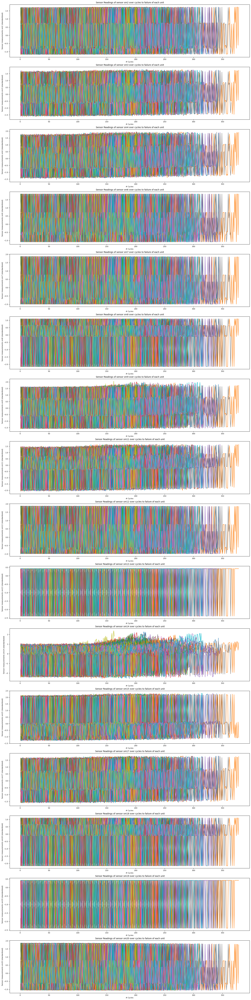

In [54]:

fig, axes = plt.subplots(nrows=16, ncols=1, figsize=(16,64), constrained_layout = True)

cols = train.columns
cols2 = cols[4:20].copy()

for j,ax in enumerate(axes):
    axes[j].set_xlabel('# Cycles')
    axes[j].set_ylabel(f'Sensor measurements {cols2[j]} (standardized)')
    axes[j].set_title(f' Sensor Readings of sensor {cols2[j]} over cycles to failure of each unit')
    for i in range(1,260+1):
        ax.plot(train[train.unit==i].time.to_numpy(), train[train.unit==i][cols2[j]].to_numpy())
    # end
# end


## These Beautiful 'Monet' Graphs are quite telling as you can almost see where in general the sensors begin to go haywire after about 125 days

In [55]:
print(train.shape)

(53758, 25)


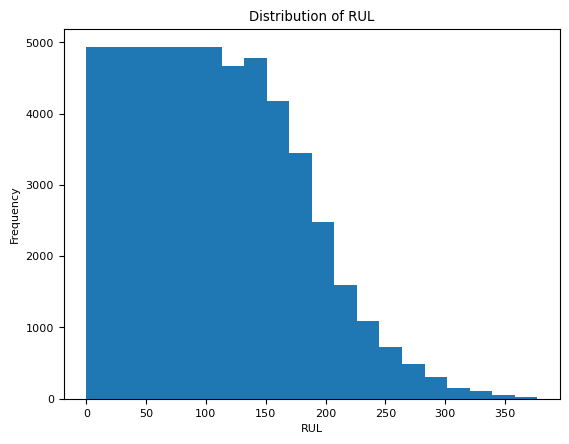

In [56]:
plt.hist(train['RUL'], bins=20)
plt.xlabel('RUL')
plt.ylabel('Frequency')
plt.title('Distribution of RUL')
plt.show()

## Lets look at the data with the standardized variables

C:\Users\Mike Dubois\AppData\Local\Temp\ipykernel_11964\3902760035.py:13: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


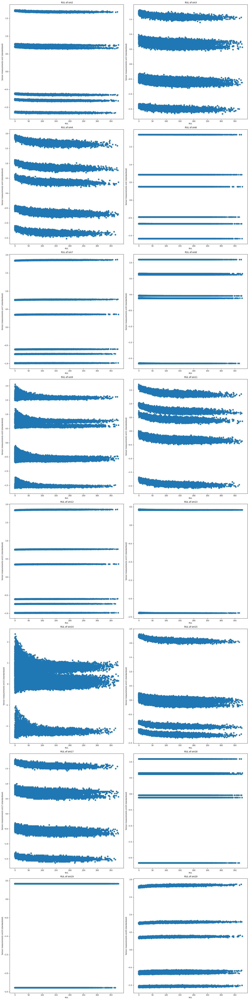

In [57]:
fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(16,64), constrained_layout = True)

cols = train.columns
cols2 = cols[4:20].copy()

for i in range(8):
    for j in range(2):
        ax = axes[i, j]
        ax.set_xlabel('RUL')
        ax.set_ylabel(f'Sensor measurements {cols2[i*2+j]} (standardized)')
        ax.set_title(f' RUL of {cols2[i*2+j]}')
        ax.scatter(train['RUL'],train[cols2[i*2+j]])
        plt.tight_layout()

# Scatterplots without the standardized Data

C:\Users\Mike Dubois\AppData\Local\Temp\ipykernel_11964\3293856906.py:13: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


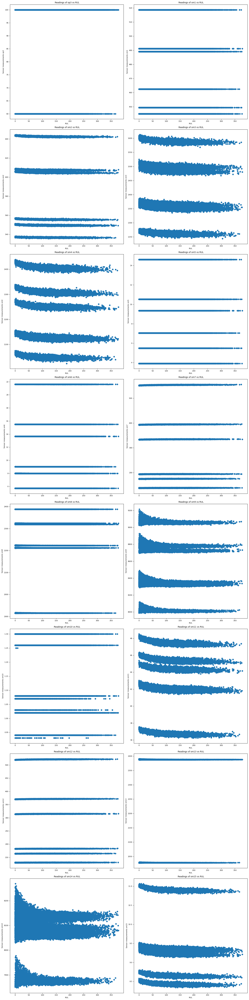

In [58]:
fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(16,64), constrained_layout = True)

cols = train_OG.columns
cols2 = cols[4:20].copy()

for i in range(8):
    for j in range(2):
        ax = axes[i, j]
        ax.set_xlabel('RUL')
        ax.set_ylabel(f'Sensor measurements {cols2[i*2+j]}')
        ax.set_title(f' Readings of {cols2[i*2+j]} vs RUL')
        ax.scatter(train_OG['RUL'],train_OG[cols2[i*2+j]])
        plt.tight_layout()

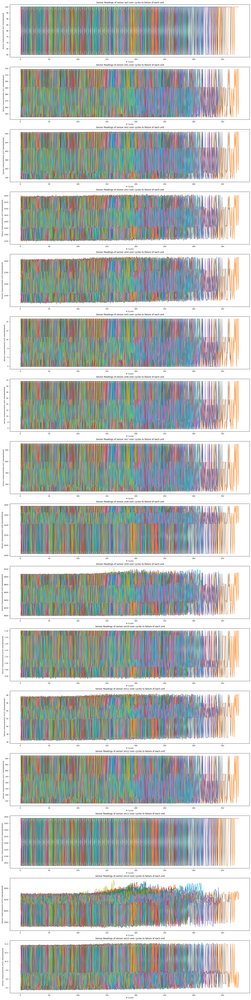

In [59]:
fig, axes = plt.subplots(nrows=16, ncols=1, figsize=(16,64), constrained_layout = True)

cols = train_OG.columns
cols2 = cols[4:20].copy()

for j,ax in enumerate(axes):
    axes[j].set_xlabel('# Cycles')
    axes[j].set_ylabel(f'Sensor measurements {cols2[j]} (standardized)')
    axes[j].set_title(f' Sensor Readings of sensor {cols2[j]} over cycles to failure of each unit')
    for i in range(1,260+1):
        ax.plot(train_OG[train_OG.unit==i].time.to_numpy(), train_OG[train_OG.unit==i][cols2[j]].to_numpy())
    # end
# end
